# Separating data

In [12]:
import os
import pandas as pd
import numpy as np

In [13]:

result_dir='./results/'
data_dir='./FullKantarData/'
figure_dir="./figures/"
os.listdir(data_dir)

['2022_shops.dta',
 'Datos_2022.csv',
 'trial.dta',
 '2022_raw_1-20.csv',
 'retyped.xlsx',
 'Explicacion_VariablesV3.xlsx',
 '2022_o_20-100.dta',
 'Explicacion_VariablesV2.xlsx',
 '2022_raw_100-1000.csv',
 '2022_raw_20-100.csv',
 'Explicacion_VariablesV3.numbers',
 'eng_re_typed.csv',
 '2022_o_1500-inf.dta',
 'Carrefour_2019_2020_2021_prepared2_02_11_2023.dta',
 '2022_raw_100-1500.dta',
 '2022_o_100-1500.dta',
 're_typed.csv',
 '2022_raw_20-100.dta',
 '2022_products.dta',
 '2022_customers.dta',
 '2022_purchases.dta',
 '2022_raw_1500-inf.dta',
 '2022_raw_1-20.dta',
 '2022_o_1-20.dta']

In [14]:
year=2022


In [15]:
read_able_columns = pd.read_excel(data_dir+'Explicacion_VariablesV3.xlsx', engine='openpyxl')


In [166]:
# remove culumns that are not needed
# TODO - put to other worksheets or something
# TODO -CodIndividuo should go to shops

def get_name(year,state,interval):
    return f'{year}_{state}_{interval[0]}-{interval[1]}.dta'

#codevf vs codproducto??
product_attributes=['CodProducto','CodigoBarras','CodVF', 'VF', 'SA7_BPL', 'SA4_Fabricante', 'SA3_Marca',       'SA2_Submarca',
       'X102_Aditivos', 'X108_Usuario', 'X109_Estado', 'X112_Niv_Calorias',
       'X124_Estilo', 'X127_Tipo_Bañado_Choc', 'X129_Tipo_Pasteleria',
       'X135_Uso', 'X143_Tipo_Corte', 'X163_Info_Cafeina',
       'X167_Grado_Curacion', 'X169_Cont_Materia_Grasa', 'X174_Despiece.Corte',
       'X182_Tipo_Queso', 'X188_Tipo_Pan', 'X189_Tipo_Viena',
       'X206_Tipo_Pescado', 'X230_Niv_Concentracion',
       'X314_Tipo_Cena.Entrante', 'X315_Tipo_Carne', 'X323_Tipo_Sazonamiento',
       'X328_Tipo_Aceite', 'X329_Pureness_Niveau', 'X360_Tipo_Verdura',
       'X366_Tipo_Postre', 'X383_Tipo_Yogurt', 'X384_Tipo_Cena',
       'X489_Como_Compro.', 'X490_Fresca.Congelada', 'X491_Presentacion',
       'X497_Tipo_Queso', 'X498_Marcas_Queso', 'X500_Tipo_Embutido',
       'X514_Tipo_Carne', 'X527_Tipo_Cafe', 'X529_Tipo_Producto',
       'X531_Info_Biologica', 'X558_Variedad_Queso', 'X571_Peso_Bebe',
       'X674_Tipo_Helado', 'X901_Localizacion', 'X902_Tipo_Producto',
       'X903_Envase', 'X904_Variedad.Sabor', 'X5_Num_Tot_Unidades',
       'X18_Num_Tot_Paquetes.Botes', 'X66_Preferred_Unit_Measure',]

purchase_attributes=['idCompra', 'CodPanelista','CodigoBarras', 'CodProducto','FechaCesta',	'PrecioCompra', 'Cantidad', 'Precio', 'CodLugarCompra','CodIndividuo','TipoMaquina', 'Promo_Folleto', 'Promo_Envase', 'Promo_TPR','promo']

shop_attributes=['CodLugarCompra','Lugar_Compra','Canal','CodIndividuo']


customer_attributes=['CodPanelista', 'CC_AA', 'Edad_Ama', 'NF', 'Numero_Gatos','Numero_Perros', 'Presencia_Niños', 'CodIMC', 'IMC', 'Ponderacion','Ciclo_Vida', 'Clase_EGM', 'Clase_Social', 'Habitat_Metropolitano',
       'Habitat_Municipal_Std', 'Inmigrante', 'Provincia', 'Region',]

tables={'customers': customer_attributes,'purchases':purchase_attributes,'products': product_attributes,'shops':shop_attributes }

In [17]:
specific_names={
    'Presencia_Niños'  :   'Presencia_Ninos',
    'X127_Tipo_Bañado_Choc'   :   "X127_Tipo_Banado_Choc",
    'X174_Despiece.Corte'   :   "X174_Despiece_Corte",
    'X314_Tipo_Cena.Entrante'   :   "X314_Tipo_Cena_Entrante",
    "X489_Como_Compro."   :   "X489_Como_Compro_",
    "X490_Fresca.Congelada"   :   "X490_Fresca_Congelada",
    "X904_Variedad.Sabor"   :   "X904_Variedad_Sabor",
    "X18_Num_Tot_Paquetes.Botes"   :   "X18_Num_Tot_Paquetes_Botes"
}


def exchange_names(specific_names,df):
    return df.rename(specific_names)


def save_dta(name, df, csv=False):
    if csv:
        df.to_csv(name.replace('.dta','.csv'))
    exchange_names(specific_names,df).to_stata(name)
    

In [18]:
# define mapping of types
type_dict=dict(zip(read_able_columns['Variable'].str.strip(),read_able_columns['Tipo Variable'].str.strip()))
type_translation={'ID':'int64','Fecha':'datetime','Numérica':'int64','Categórica':'category','Dicotómica':'bool'}   

In [19]:
type_dict_new ={ k:type_translation[v] for k,v in type_dict.items() }
type_dict_new={('X'+k if k[0].isdigit() else k):v for k,v in type_dict_new.items() }
type_dict_new['CodigoBarras']='str'
# TODO categorical vs int vs string...
# TODO check why it is needed , leave as categorical now..
type_dict_new['Presencia_Niños']='category'
# when reading, should be given... 
del type_dict_new['FechaCesta']
# because stata cannot handle too many categories with long names:
for cn in product_attributes:
       if type_dict_new[cn]=='category':
              type_dict_new[cn]='str'

In [63]:
# load data

source_df_test=pd.read_csv(data_dir+f'Datos_{year}.csv',#nrows=1000,
                           encoding = "ISO-8859-1", delimiter=";" ,error_bad_lines=False, parse_dates=['FechaCesta'])

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (28,42,45,51) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [64]:
# transform 
source_df_test['Promo_Envase']=source_df_test['Promo_Envase'].map({'No':False, 'Si':True})
source_df_test['Promo_Folleto']=source_df_test['Promo_Folleto'].map({'No':False, 'Si':True})
source_df_test['Promo_TPR']=source_df_test['Promo_TPR'].map({'No':False, 'Si':True})

In [65]:
source_df_test=source_df_test.astype(type_dict_new)


In [66]:
source_df_test['promo']= np.where( source_df_test['Promo_Folleto'] | source_df_test['Promo_Envase'] | source_df_test['Promo_TPR'],True,False)
source_df_test['promo'].value_counts()


False    6908404
True      675753
Name: promo, dtype: int64

In [67]:
# separating the tables:
for name,attributes in tables.items():
    save_dta(data_dir+f'{year}_{name}.dta',source_df_test[attributes].drop_duplicates())
       #.to_stata(data_dir+f'{year}_{name}.dta')

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/io/stata.py:2398: InvalidColumnName: 
Not all pandas column names were valid Stata variable names.
The following replacements have been made:

    Presencia_Niños   ->   Presencia_Ni_os

If this is not what you expect, please make sure you have Stata-compliant
column names in your DataFrame (strings only, max 32 characters, only
alphanumerics and underscores, no Stata reserved words)

  warnings.warn(ws, InvalidColumnName)
/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/io/stata.py:650: ValueLabelTypeMismatch: 
Stata value labels (pandas categories) must be strings. Column NF contains
non-string labels which will be converted to strings.  Please check that the
Stata data file created has not lost information due to duplicate labels.

  ValueLabelTypeMismatch,
/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/io/stata.py:650: ValueLabelTy

In [14]:
source_df_test.groupby(['CodIndividuo','CodLugarCompra']).size()
# seems like codIndividuo is CodLugarCompra

CodIndividuo  CodLugarCompra
0             1                   2334
              2                 104807
              3                 163621
              4                      1
              5                 115544
                                 ...  
7             901                    0
              902                    0
              990                    0
              991                    0
              999                    0
Length: 3008, dtype: int64

In [15]:
source_df_test.groupby(['Lugar_Compra','CodLugarCompra','CodIndividuo']).size()


Lugar_Compra                                        CodLugarCompra  CodIndividuo
AGRIGEL                                             1               0               2334
                                                                    1                389
                                                                    2                 46
                                                                    3                 43
                                                                    4                  3
                                                                                    ... 
Zooplus                                             999             3                  0
                                                                    4                  0
                                                                    5                  0
                                                                    6                  0
                             

## seems like multiple CodIndividuos belong to one  CodLugarCompra, and CodLugarCompra corrsponds to Lugar_compra

## so a single puschanse place can be identified by ('CodLugarCompra','CodIndividuo') 

In [16]:
# how many barcode per product code
source_df_test['bc_per_cp']=source_df_test[['CodProducto','CodigoBarras']].drop_duplicates().groupby('CodProducto')['CodigoBarras'].transform(lambda x: ','.join(x))


In [17]:
# how many product code per barcode
source_df_test['cp_per_bc']=source_df_test[['CodProducto','CodigoBarras']].drop_duplicates().groupby('CodigoBarras')['CodProducto'].transform(lambda x: ','.join(x.astype(str)))

In [18]:
source_df_test.head()

,idCompra,CodPanelista,CodProducto,CodigoBarras,FechaCesta,PrecioCompra,Cantidad,Precio,CodLugarCompra,Lugar_Compra,...,Habitat_Metropolitano,Habitat_Municipal_Std,Inmigrante,Provincia,Region,promo_folleto,promo_envase,promo,bc_per_cp,cp_per_bc
0,191945938,364917,791031,8480000105424,2022-12-12,1650,12000,1716,79,Mercadona,...,AM Madrid,más 1000000,True,Madrid,MDD AM,NaN,NaN,False,8480000105424,791031
1,190744241,30109,675179,8410702020886,2022-11-06,400,2000,400,28,CONDIS,...,No Metrop,20001 a 30000,True,Jaen,Andalucia,NaN,NaN,False,8410702020886,675179
2,182162741,30109,204305,SSA1410202,2022-01-20,2088,445,56,33,DIA,...,No Metrop,20001 a 30000,True,Jaen,Andalucia,NaN,NaN,False,SSA1410202,204305
3,189827808,30109,204305,SSA1410202,2022-10-09,1071,625,87,33,DIA,...,No Metrop,20001 a 30000,True,Jaen,Andalucia,NaN,NaN,False,NaN,NaN
4,182203652,30109,204305,SSA1410202,2022-01-12,969,935,83,33,DIA,...,No Metrop,20001 a 30000,True,Jaen,Andalucia,NaN,NaN,False,NaN,NaN


In [19]:
# multiple barcodes per product code

barcode_with_multiple_PC= source_df_test.loc[ source_df_test['bc_per_cp'].str.contains(',', na=False)]



In [172]:
barcode_with_multiple_PC.shape[0]

NameError: name 'barcode_with_multiple_PC' is not defined

In [20]:
barcode_with_multiple_PC[['CodProducto','CodigoBarras','bc_per_cp']].sort_values('CodProducto').head()

,CodProducto,CodigoBarras,bc_per_cp
4944764,13755,E8A14003010704650308,"E8A14003010704650308,E8A14002010704650308"
5099037,13755,E8A14002010704650308,"E8A14003010704650308,E8A14002010704650308"
892504,58161,E8A14201050404380308,"E8A14201050404380308,E8A14203050404380308"
1006060,58161,E8A14203050404380308,"E8A14201050404380308,E8A14203050404380308"
55682,94970,24010702,"24010702,000024010702"


In [21]:
# multiple product codes per barcode
pc_with_multiple_barcode=source_df_test.loc[ source_df_test['cp_per_bc'].str.contains(',', na=False)]


In [22]:
pc_with_multiple_barcode[['CodigoBarras','CodProducto','cp_per_bc']].sort_values('CodProducto').head()

,CodigoBarras,CodProducto,cp_per_bc
886335,7613287477972,7180,"7180,7189"
886449,7613287477972,7189,"7180,7189"
3948553,2004060030999,8044,"99337,8044"
147227,8410843035565,8662,"8662,429543"
14868,8006540429457,8697,"8697,8700"


In [27]:
#pc_with_multiple_barcode.sort_values('CodigoBarras').to_stata(result_dir+f'{year}_multiple_CP_per_CB.dta')
#barcode_with_multiple_PC.sort_values('CodProducto').to_stata(result_dir+f'{year}_multiple_CB_per_CP.dta')

save_dta(result_dir+f'{year}_multiple_CP_per_CB.dta',pc_with_multiple_barcode.sort_values('CodigoBarras'),csv=True)
save_dta(result_dir+f'{year}_multiple_CB_per_CP.dta',barcode_with_multiple_PC.sort_values('CodProducto'),csv=True)



/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/io/stata.py:2398: InvalidColumnName: 
Not all pandas column names were valid Stata variable names.
The following replacements have been made:

    Presencia_Niños   ->   Presencia_Ni_os
    X127_Tipo_Bañado_Choc   ->   X127_Tipo_Ba_ado_Choc
    X174_Despiece.Corte   ->   X174_Despiece_Corte
    X314_Tipo_Cena.Entrante   ->   X314_Tipo_Cena_Entrante
    X489_Como_Compro.   ->   X489_Como_Compro_
    X490_Fresca.Congelada   ->   X490_Fresca_Congelada
    X904_Variedad.Sabor   ->   X904_Variedad_Sabor
    X18_Num_Tot_Paquetes.Botes   ->   X18_Num_Tot_Paquetes_Botes

If this is not what you expect, please make sure you have Stata-compliant
column names in your DataFrame (strings only, max 32 characters, only
alphanumerics and underscores, no Stata reserved words)

  warnings.warn(ws, InvalidColumnName)
/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/io/stata.py:650: ValueLa

In [179]:
Cb_with_more_cope_product1= pd.read_stata(result_dir+f'{year}_multiple_CP_per_CB.dta')

In [178]:
Cb_with_more_cope_product['CodProducto'].unique()

array([ 13755,  58161,  94970, 373983, 428872, 603555, 798296],
      dtype=int32)

In [177]:
Cb_with_more_cope_product['CodigoBarras'].unique()


array(['E8A14003010704650308', 'E8A14002010704650308',
       'E8A14201050404380308', 'E8A14203050404380308', '24010702',
       '000024010702', '20941000', '000020941000', 'E8A14201020304700208',
       'E8A14203020304700208', '000024017282', '0000024017282',
       '24010801', '000024010801'], dtype=object)

In [176]:
Cb_with_more_cope_product= pd.read_stata(result_dir+f'{year}_multiple_CB_per_CP.dta')


## Both CodigoBarras can have multiple CodProducto and the other way around

# Separating based on transaction numbers per products and channels

In [27]:
transaction_limits = [1, 20, 100,1000, 1500, np.inf]
intervals = list(zip(transaction_limits[:-1], transaction_limits[1:]))
dfs={}



In [76]:
# count how many transaction has been made in a given channel relating a product, handling promotions separately
canal_product_groups_counts=source_df_test.groupby(['Canal','CodProducto','promo']).size().to_frame('size')



In [79]:
canal_product_groups_counts.head()

size
Canal       CodProducto promo      
AUTOCONSUMO 2           False     0
                        True      0
            4           False     0
                        True      0
            8           False     0

In [80]:
canal_product_groups_counts=canal_product_groups_counts.reset_index()


In [81]:
# dropping product, channel combinations with no transaction
canal_product_groups_counts=canal_product_groups_counts[canal_product_groups_counts['size']>0]

In [82]:
canal_product_groups_counts.head()

,Canal,CodProducto,promo,size
958,AUTOCONSUMO,1193,False,1
1014,AUTOCONSUMO,1231,False,1
1176,AUTOCONSUMO,1367,False,5
1876,AUTOCONSUMO,3024,False,1
2352,AUTOCONSUMO,3675,False,1


In [100]:
t1=canal_product_groups_counts.head()

,Canal,CodProducto,promo,size
958,AUTOCONSUMO,1193,False,1
1014,AUTOCONSUMO,1231,False,1
1176,AUTOCONSUMO,1367,False,5
1876,AUTOCONSUMO,3024,False,1
2352,AUTOCONSUMO,3675,False,1


In [101]:
source_df_test[purchase_attributes].head()

,idCompra,CodPanelista,CodProducto,FechaCesta,PrecioCompra,Cantidad,Precio,CodLugarCompra,CodIndividuo,TipoMaquina,Promo_Folleto,Promo_Envase,Promo_TPR,promo
0,191945938,364917,791031,2022-12-12,1650,12000,1716,79,0,PDT / Beauty Smart,False,False,False,False
1,190744241,30109,675179,2022-11-06,400,2000,400,28,1,Smartphone,False,False,False,False
2,182162741,30109,204305,2022-01-20,2088,445,56,33,0,Smartphone,False,False,False,False
3,189827808,30109,204305,2022-10-09,1071,625,87,33,0,Smartphone,False,False,False,False
4,182203652,30109,204305,2022-01-12,969,935,83,33,0,Smartphone,False,False,False,False


In [102]:
purchase_attributes+['Canal']

['idCompra',
 'CodPanelista',
 'CodProducto',
 'FechaCesta',
 'PrecioCompra',
 'Cantidad',
 'Precio',
 'CodLugarCompra',
 'CodIndividuo',
 'TipoMaquina',
 'Promo_Folleto',
 'Promo_Envase',
 'Promo_TPR',
 'promo',
 'Canal']

In [104]:
source_df_test.shape[0]

7584157

In [106]:
# separating the transactions based on now many have been made, because different scopes (shops vs channels vs categories) outlier detection methods (simple z score based method or z score around price curve) can be applied for different number of transaction
dfs={}
count=0
for t in intervals:
#    a = canal_product_groups_counts[canal_product_groups_counts.ge(t[0]).lt(t[1])]
    b = canal_product_groups_counts[(canal_product_groups_counts['size']>t[0]) & (canal_product_groups_counts['size']<t[1])]
    dfs[(t[0],t[1])]=source_df_test[purchase_attributes+['Canal']].merge(b)
    no=dfs[(t[0],t[1])].shape[0]
    print(no)
    count+=no
    print('------------')

print('sepatared count: ',count)
print('original count :',source_df_test.shape[0])


1108015
------------
1523798
------------
3041437
------------
485295
------------
1236919
------------
sepatared count:  7395464
original count : 7584157


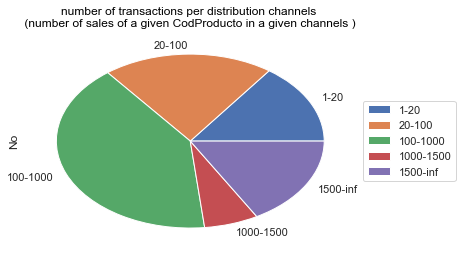

In [171]:
import matplotlib.pyplot as plt
%matplotlib inline
counts=[dfs[(t[0],t[1])].shape[0] for t in intervals]
names=[f'{t[0]}-{t[1]}' for t in intervals]

df = pd.DataFrame({'No': counts},
                  index=names)
f = plt.figure()

plt.title('number of transactions per distribution channels \n (number of sales of a given CodProducto in a given channels ) ', color='black')
df.plot(kind='pie',y="No", ax=f.gca())
plt.legend(loc='center left', bbox_to_anchor=(1.0, 0.5))
plt.savefig(figure_dir+f'{year}_transaction_counts.png',bbox_inches='tight')
plt.show()

In [108]:
def get_name(year,state,interval):
    return f'{year}_{state}_{interval[0]}-{interval[1]}.dta'

In [109]:
# saving the group of transaction (based on per channel transaction counts) into different files
#[dfs[(t[0],t[1])].to_stata(data_dir+get_name(year,'raw',t)) for t in intervals[:2]]
[save_dta(data_dir+get_name(year,'raw',t),dfs[(t[0],t[1])],True) for t in intervals]



/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/io/stata.py:650: ValueLabelTypeMismatch: 
Stata value labels (pandas categories) must be strings. Column CodIndividuo contains
non-string labels which will be converted to strings.  Please check that the
Stata data file created has not lost information due to duplicate labels.

  ValueLabelTypeMismatch,


[None, None, None, None, None]

In [ ]:
# free some memory
for t in intervals:
    del dfs[t]
del source_df_test

# Otliers

In [11]:

for t in intervals[1:]:
    dfs[t] = pd.read_stata(data_dir + get_name(year, 'raw', t))

FileNotFoundError: [Errno 2] No such file or directory: './data_kantar/2022_raw_100-1000.dta'

In [110]:
# 
#https://www.analyticsvidhya.com/blog/2022/08/outliers-pruning-using-python/
def model_poly(df):
    # for throwing out outliers iteratively if we like, to have a better regression  
    cleaning_rounds=1
    Y = np.array(df['price_per_unit'])
    X = np.array(df['t'])
    #flag=np.zeros(y.size)
    idx=df[['price_per_unit']].index.copy()
    x=X.copy()
    y=Y.copy()
    print(x)
    for i in range(cleaning_rounds):
        p = np.polyfit(x, y, deg=5)
        ps = np.polyval(p, x)
        diff = abs(y-ps)
        std=np.std(diff)
        mean=np.mean(diff)
        good =  abs(diff-mean)/std < 3 
        #good = abs(y - ps) < 1  # Here we will only remove positive outliers
            
        x_bad, y_bad = x[~good], y[~good]
        x, y = x[good], y[good]

   

        if (~good).sum() == 0:
            break
    ps = np.polyval(p, X)
    diff = abs(Y-ps)
    std=np.std(diff)
    mean=np.mean(diff)
    z= abs(diff-mean)/std
    good =  z < 3 
    flag = np.logical_not(good)
  
    ret= pd.DataFrame(index=idx, data=list(zip(ps, z,flag)), columns=['1','2','3'])

    return ret

# For putting back answer: 
# https://stackoverflow.com/questions/68555285/typeerror-incompatible-index-of-inserted-column-with-frame-index-when-applying

def per_canal_polynomial_detection(df):
    # transform date
    df['t'] = df['FechaCesta'].astype('datetime64').dt.dayofyear
    # calculate price per unit of sales
    df['price_per_unit']= df['Precio']/df['Cantidad']
   
    x=  df.groupby(['CodProducto','Canal'])[['t', 'price_per_unit']].apply(model_poly).reset_index().set_index('level_2').drop(['CodProducto','Canal'],axis=1)
    df[['predicted', 'z', 'outlier']] = x
    
    return df
   


In [111]:
# per channel per product detection for all the groups, but the one with very few transaction
for t in intervals[1:]:
    df = dfs[(t[0], t[1])]
    df = per_canal_polynomial_detection(df)
    df['outlier_detection'] = "canal_poly"
    #df = df.drop('level_0', axis=1)
    df = df.reset_index(drop=True)
    df.to_stata(result_dir + get_name(year, 'o', t))
    #del df




[351 329 356 364 351 340 353  45 364 338 351 357  32  12 356 344 328 361
 326 365 364 357 330 326 354 365 361 349 349 326 327 356  29  40  25  10
 341   5 338 332  11 357 339 354  35]
[357 357 349 185 119 153 255 134 178  55  25 123  76 307 343 277 152 119
 208 306 137 348  82 115  34 244 321 333  90 155 258  42  24 294 302 146
  62 246 314  94 325 330  69 255 173 231 195 101 276   5 314 204  56 185
 153 185  89 234 358 346 354]
[ 38  22  73 362  27  88  14  18  32 131 251 272 280  28 134 228 354 147
  90  75  18 316 354 312 334]
[268  80 160  35 184 176  21 353  36 101 101 292 127  36 323 309  64  50
 246 176 267  13 174 288 130 269  17]
[216  60 260 277  41 201 318  22  68 244 266 133 262 294   5  42  99 279
 161 216 175 232 152 141 143 126 206]
[243 202 363 353 138 322 159 102 288 300 192 111 136 284 181  27 212  26
   3  80 353 333 204 164 190 306]
[288 186 315 230  69 262 323 361 361 315  51  78 296 282 301 289  86 114
 196  43  20  42 164 270  75  56 333 361 101 139  77 101  62 2

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/core/groupby/ops.py:965: RankWarning: Polyfit may be poorly conditioned
  return libreduction.apply_frame_axis0(sdata, f, names, starts, ends)


[280 128 273 251 138 274 271 280 120 286 262 125 290 251 258 260 250 245
 108 131 111 127 130 127 302 281]
[106 237  29 152   5 182 203   7 271 210 197 155 155 260 238 245 141  12
  11  42  71  99 259  15]
[133 260 315 339 283 330 323 316 344 363  76 245 162  24  45  60  66  17
 115  94  38 108 120 129  52  87 288 260  73 267  31 295 154  10 101 148
  80 274 190  76 264]
[228 221 222 218 220 214 223 225 225 214 213 213 228 221 216 228 225 228
 221 222 223 224 231 224 228 223 221 230 221 228 224 225 220 214 237 129
 222 217 213 217 221 229 224 229 224 225 225 228 225]
[140 161 181 132 206 146 336 301  42  15  84 173  28  28 322  57  82  14
 197  47 103  96  26 155 185  70  35 211   5 112 170 164   8 111  90  98
  34  52  56 348  14 267 202  88  21]
[106 220  10   5 221   5   8   7 108   8   8 217 216 316 312 313  25 311
 311 312   8   7   8 311  24   7 309 108 312  26 311 316   8 315 110 110
  17   7   7   8   3 108   8 315 109   5   7 220   5 320   5 311  11 208
   7   9   7   5 206 21

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/core/groupby/ops.py:965: RankWarning: Polyfit may be poorly conditioned
  return libreduction.apply_frame_axis0(sdata, f, names, starts, ends)


[ 29 308 266  99 155 189  77 176 203 134 148  38 114 257 127  58  73  87
 302  22 141 315 290 353 132 214  74 364 292 292 287 304 258  13 227 280
 143 249 236  12  20 274  36 213 260]
[194 328 134 219 248 363  38  61 135  44   7 353 317  90 147 158 198  35
 305 118 325 150  70 218 350  57   7  18 246 117  87 134 288  27  63  41
  53 179  54 145 194 298 141 185 155]
[133 101  61 116 117  64  98 151 116 353 336  49 248 101 351 343 185  21
 101 141 162 230  52  99 132 106 356  56 363  70  77 126  69 147 133 116
  18 112 109  14 155 211  71 167  61  76 146 153 140  68  20 181 224 167
 147 126 136 343  95 138  73]
[147 158 336 176 302 323 142 309 271 106   3 102 224 365 292 364 348 269
 322 195  30  57 186 115 283 325 276 164 297  66  52  73 136 150  94 229
  94 242 242 119  89 329  72 111  59 162 147  31  63 106 316 183  85  43]
[246 292  27  57 339  66 258  33  26 131  87 279 187  29  10  62 103  71
 178  89  65 164  48  41  55 217 210 118 178  20 171  73  51  51  11  92]
[ 36 113  72 131

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/core/groupby/ops.py:965: RankWarning: Polyfit may be poorly conditioned
  return libreduction.apply_frame_axis0(sdata, f, names, starts, ends)



[302 101 192 169 144 123 264 326 316 271 223 174 190 333 250 260 218 330
 350 312 295 180 243 291 355  30 301 122 101  83  71  45  98  77 351 145
  31 165 245  56 322 119 301 218  46]
[ 55  21  59  55 213  66  20  19  42  63  77  34 116 173  64  64  68  14
  36  39  56  34  47  66]
[329 225 242 247 260 182 288 209 314 195 339 358 335 311 145 210 262 126
 132 356 326 341 202 258 255 245  82 233 127  76 287 118 329 260 275 170
 235 300 246 259 134 322  63 133  76  91 273 329 134 240 329 127 134 113
 263 236 310 133 161 182 147 161]
[257 175 243  93 126 240 316 211  77 309 184 344 116 126 191  98 237 248
 163  99 279 269 241 182 335 118  61  76 193 242 234 240 124 136 229 251
 218  74 235 231 355 306  72 306 355 322 111 313 297 182 167  83  83 129
 124 288 229 230 230]
[153 332 322 350 339 279 364 231 246 189 227 182 232 178 345 148 144 341
 334  68 328 353 245 248 350  99 189 362 352 294 177 334 113 161 155 218
 251  76 140 197 232  94 127 104 343 212 311 253 246 343 165 144 126 113
 17

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/core/groupby/ops.py:965: RankWarning: Polyfit may be poorly conditioned
  return libreduction.apply_frame_axis0(sdata, f, names, starts, ends)



[ 88 115 130 293 295 348 339 357 361 343 362 117 353 346 365 358 341 357
 336 111 347 293 337 363  88 123 122  98 130  99 113  99 109 106 111]
[ 64 319 332 306 250  64  94 348 257 243 215  17  67 339 193 356 314 284
  24 316 251  17 199 155  64  47  25]
[225 239 230 231 228 228 231 225 125 224 228 221 234 228 229 229 232 300
 237 223 232 231 224 221 221 234 144 231 165 236 232 221 228 236 140 237
 228 225 220 225 232 221 225 234 221 225]
[ 27  13 119  32 307  92 204 297 344 138 347 173 346  71  42  16 209  77
 313 349 349  63 221 356 308  75 308 175  91 301  84 294 280  35 154 168
  63 133 238 336  98 266 217 189 126 146 196 231 308  21  14 112 140  42
 273 245 153 179 197 117   7 295  86 192  31 150]
[108 184 357 152  99 323 337 106 125  22 329 272 291 301 329 277 286  28
  77  21  35 268  91  73 172 101 253  39 166 177 361 104  21 337 267 127
  45 108 109 102 168 334 147  14 223  42 182 280 126  63 258 299  27 363
  35 101  76 109 168   8 153  41  47  21  53 108 108  67  40 122 167 

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/core/groupby/ops.py:965: RankWarning: Polyfit may be poorly conditioned
  return libreduction.apply_frame_axis0(sdata, f, names, starts, ends)



[260 280 221 255 312 354 248 246 251 203 273 208 349 248 223 320 224 357
 332 316 336 313 221 317 218 220 361 304 201 287 242 321 220 223 210 223
 314 321 213 329 312 221 271]
[247 265 228 253 283 230 231 281 271 251 288 230 278 260 273 263 249 265
 214 308 206 221 267 202 215 213]
[329 252 355 259 251 266 280 284 218 314 302 251 338 320 235 242 342 260
 286 262 251 244 336 286 344 279 286 311 306 230 330 300 206 230 362 314
 330 280 332 341 335 333 332 332 301 347 302 216 311 319 323 321 327 314
 313 321 308 306 322 330 326 304 315 306 325 316 327 308 329 323]
[277 311 337 215 259 354 334 270 301 214 225 283 204 269 306 354 279 293
 304 287 318 321 293 326 281 286 335 357 269 335 316 323 339 319 353 357
 315 306 206 232 299 298 259 277 213 321 239 309 259 353 306]
[202 211 201 213 202 228 218 242 210 203 211 202 204 218 212 222 204 211
 204 211 200 247 218 204 203]
[220 182 315 183 250 154 235  55 287 181  99 339  29 351  57 281 165 245
  22  68 110]
[260 165 358 234 336  29 255  32 

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in true_divide
/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in true_divide


[196 179 155 155 151 154 159  21  21 146 143 160 337 246 253 176 234 194
 164 143 137 303 225 147]
[ 95 182 228 287 294 316 309 229 236 312 252 333 246 292  65 102  27 311
 161  18   8 277 263]
[255 199 235 207 279 259 298 262 259 260 283 266 225 281 168 183 171 196
 164 267 315 312 202 272 248 208 299 201 307 218 292 257 230 218 185 280
 308 216 180 277 194 286 269 292 228 278 278  81 199 190 263 264 309 219
 199 325 192 263 171 279 215 277 288 290 178 190 214 195 263 199 182 277
 250 239 196 154 178 295]
[272 126 200 176 165 236 175 182 195 182 197 232 190 193   5  43 214 196
 211 271 242 167 124  32 113  35 118  60 195 151  54 146 235 205 197 162
 211 188]
[122 283 273 256 312   5 249 350 341 201 139 321 214 110  64 339  69  29
 281 365 223  20 162 120 123  19  36]
[276 300 341 335 281 261 323 297 330 323 346 265 362 360 299 280 314 270
 338 329 343 330 328 336 315 261 351]
[ 14 189 301 241 306 294 300 253 218 281 316 216 207 104 151 246  77 116
 204 154 308 196 173 141 181 206 353 

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/core/groupby/ops.py:965: RankWarning: Polyfit may be poorly conditioned
  return libreduction.apply_frame_axis0(sdata, f, names, starts, ends)



[292 337 238  90 249 249 357 294 309 218  61 190 248  21  88 123  76 339
 292  78  16  65 100 239  16]
[ 29 272  89 275  81  21  84 352  24 197 339 318 185  94 259  12  56 104
  29 362 236  40 294 315 280  75 274 333 309  42 341 108]
[294 326  48 269 316 221 131 140 328 314 241 144 258 232 255 119 288 141
 115 294 120  77  12  49  13 265 182]
[196 100 150 294 119 133 260 146 192 252  91 112 203   7 140  26   5  64
  49  70 266  16  45 160 181 153  77 179 130 306 130 246 274 260 131 243
 337  74  69 136 353 236 134 221 221]
[250 196 328  12 219 201 190 267   3  21  29 364 223 272 125 256 132 350
  19  87 185 298 326 314 212 132 256 279]
[329 280 168 287 326 350 333 110  38  27 313 320 185  80 164 270  39 124
 124  47 125 309  78 105 248 166   7]
[328  77 351 122 134  73 321 213 309 364 362  38 248 343  76  79 170 318
 266  39  66  89  75  71 134  18  38  32]
[288 302 271 188 329 264 264 281  10  34  23  71 151 172  14 309  38  63
  83  78  65]
[ 27   7  38  43  18  54  33   3  21  63  

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/core/groupby/ops.py:965: RankWarning: Polyfit may be poorly conditioned
  return libreduction.apply_frame_axis0(sdata, f, names, starts, ends)
/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/core/groupby/ops.py:965: RankWarning: Polyfit may be poorly conditioned
  return libreduction.apply_frame_axis0(sdata, f, names, starts, ends)


[272 304 123 252 116 117 216 292 278  15  43   8  83 342 218 235  33 176
 236 336 157  50 340 291 314]
[197 155  43 252 190 253 210 267 134 169 168 108  50  70 236 202  56 258
  83 207 271 261 264 185 104 235 182 288 179 228 219 250]
[335 341 347 298 284 116 171  59 102 110  80  25 158  45 130 195 151  66
  31 136  96  38 284 231 147 262 323 189 174 116 126  26  91  17 215 250
  54 202  42  35 272 337 104 306]
[216 341 143 335 201 152  96  95 300 154 338 228 312 127 291   7 343  28
  25  11 143  40  39 277 132  94 120 314  65  46 120 283 348 312 133 138
 127 133  69 339  48 284  62  89  15 218 232  73 217 171 119  33  49 204
 120  19  43  35 206 164 206 134 187 316 173 313  18 152 125  60  98  13
  53  75  48 144 193 116 270 270 264 284 245 244 262 244 253 243 243 267
 259 260 298 258 267 248 248 283 256 298 256 286]
[148  94  69 280 204   3  15  12  33  42 349   8  15 102 357 357 363 122
 127  14  36  38 106 178 155 147  25 118  18  92  18 355  21  43  71 313
  41]
[168 162  26 274 26

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/core/groupby/ops.py:965: RankWarning: Polyfit may be poorly conditioned
  return libreduction.apply_frame_axis0(sdata, f, names, starts, ends)



[299  78  43 124 196 102 154 117  94 229 168  36  32 316 130 330 136 277
 250 259 190 171 208 318 280 269  70 237]
[144 162 337 330 111 238 284 276  80 213 311 315 311 269 145 104  67 162
 365 338 351 196 189 108  31 162  32 129  68 123 115 302 122 157 364 106
  85 260 278 300  71]
[ 15 341 245  62 252 186 172  51 347 168 162 304 214 217  81 111 169  21
   9  28  17  39  42  57 309 111  83 175 295 127 253 156 181 183 175  38
  36 247  86  15 330  22 183 155 169 103 113  36  97 116 262]
[274 158 277 259 210 222 130   7 272  56 195 328   8   4 189  68   4 288
  64 353 150 298 325  47 190 236 276  97 125 267 337 162 129 322 238 197
  71 257 141 246 341  84 120 278  35]
[302  64 106  71 145  34 188 229 209 350 289 214 188 273 313 262 277 150
   3  59 132 247 174 162 210 263 176 340 118 294  96  75 309]
[222 202 155 322 185 287 252 165 357 335 360 346 355 319 111  32  55  79
 108 223 266 103 181]
[ 84 252  70 176 127 140 244  33 106 273 221 351  74 248 245 260 155 279
 197 123 113 222 245 

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/core/groupby/ops.py:965: RankWarning: Polyfit may be poorly conditioned
  return libreduction.apply_frame_axis0(sdata, f, names, starts, ends)



[357 342 323  60 181   5 129 159  59 128 112 224 128 202 342 203 213 193
 299 292 232 335 270 246  61  43 132 306 301   5  12 316 249 284 117 324
 103 291 197 260 225  10 318 110  62  76 206 206 116 339 267  92 353 231
 341 215   4 250 235  42 295 117  14 173  29 244 281 119 181]
[ 49 202 137 264 179 273 241 153 198 174 112 251 266 326  45  94 257  88
 176 223 139 168 232 210  66 162 309 139 221 231 204 281 259 241 222 150
 119 246 203  43  50 154 119 357 346 102 166 311]
[  3 119 252 295  50  26 162 362 145 351 246 195  81 147 244 279 337 267
 336 145 127 180 323 362 218  89 260  49 138 203 113  36 351 274  92  78
  43 302 206  28 239 140  14 322   4 196 136 356 192 160 356  92  55 301
  56 263 365 150 127]
[265 263 104 207 255  22 277 266 334 249 125 326 326 318 223 179 216 242
 220 343 325]
[ 67 229   7 257 145  39 353 333 279 291  59 288  28 117 179  38 150 241
 281 332 127 214 158 339 341  39 264 297 315  62  86]
[148 352 341  26 126 256 360 248 288 343 225 343 322 354  35 214  2

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/io/stata.py:650: ValueLabelTypeMismatch: 
Stata value labels (pandas categories) must be strings. Column CodIndividuo contains
non-string labels which will be converted to strings.  Please check that the
Stata data file created has not lost information due to duplicate labels.

  ValueLabelTypeMismatch,


[243 241 162 290  32 143 234 264  84 346 264 258 299 237 234 312 335 284
 241 290 327 293 138 277 290 264 347  64  66  69  29 273 298 252 223 306
 299 262 258 273 231 347 174 126 306 262 312 291  28 316 194 346 103 286
 268 313 351 358 279 300 279 365 304 356 314 350 312  83 126  67 302 286
 281 154 279 258 359 159 176 270 136 112 216  47 362  10 354 321 276 298
 157 343 181 226 178 213 229 337 288 252 180 175  20  28 335 220 276 355
 154 301 306 355  77 143 184 179 253  90 361 188 276 357  22 354  52 108
  57  93  52 142  44  81  27 271 316  42 349  54  13 239 272 238  27 358
 295 327 326 318 274 291 309 270 271  12 295 312 339 358 312 305 242 266
 360 349 346 112 200  94  52]
[ 41  82 267 336 176 200 171 164 301 320  43 166 224  77 167 161 162 345
 211 178 225 178  22  77 152 306  73  32  99 349 321  38  67 101 252 106
  15  36  15  22 303 282 293  43  98 238  67  47  61  40 358 332 116 323
 269 264 237 102 341 166 307 243  49 189  35   4 298 318 273  92  63 190
 127 332 339 288 255 

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/io/stata.py:650: ValueLabelTypeMismatch: 
Stata value labels (pandas categories) must be strings. Column CodIndividuo contains
non-string labels which will be converted to strings.  Please check that the
Stata data file created has not lost information due to duplicate labels.

  ValueLabelTypeMismatch,


[ 71 190  92 ...  67   5  53]
[189 232  94 ... 221 229 234]
[241 304 181 ... 119  64 117]
[304 110 309 ... 288  39  33]
[350 237  99 ...  78 262 319]
[ 66 241 300 ... 291 155 263]
[330 307  19 ...  28  78 314]
[214 231 129 ... 281 320 318]
[ 26 129  64 ...   3 363  52]
[169  29 310 ... 364 221 281]
[267 205 258 ... 269  84 170]
[117 313 291 ... 250 279 123]
[221 157 235 ...  92 189  91]
[278 356 364 ...  80 165  11]
[ 29 214  45 ...  90 169  56]
[246 138 231 ... 271 325 298]
[ 64 274 242 ... 233 254 243]
[188 350 322 ... 298  62 228]
[132  60  63 ... 316 263 255]
[118  26  57 ... 245 339 321]
[211 246 363 ... 307 238 171]
[333 186 255 ... 101 134 364]
[299 333  96 ... 182 348 270]
[263 299 256 ... 313 190 238]
[116  91 151 ... 346  67 339]
[ 33  84  34 ... 263 314 304]
[150 154 195 ... 273 169 304]
[ 64 262 110 ...  67 347  20]
[ 82 157 257 ...  40  78  68]
[ 85 160 196 ... 249 207 348]
[ 56  83 286 ... 341 231 278]
[282 220 202 ... 160  26   5]
[ 80  36 346 ... 355 364 273]
[216 334 2

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/io/stata.py:650: ValueLabelTypeMismatch: 
Stata value labels (pandas categories) must be strings. Column CodIndividuo contains
non-string labels which will be converted to strings.  Please check that the
Stata data file created has not lost information due to duplicate labels.

  ValueLabelTypeMismatch,


[ 13  82 166 ... 213  48 353]
[346 178 178 ... 159 301 195]
[111 330 151 ... 361 147  39]
[ 89 106 341 ... 341  46 271]
[ 57  60  85 ... 253 111 109]
[267  36  22 ... 306  53 245]
[249 222  25 ...  84  24 284]
[ 47 226  33 ...  91 286  27]
[319 338 202 ...  94 334 286]
[177 313 280 ... 147 140 147]
[ 39  34 284 ... 321  99 270]
[138 220 290 ... 137 176 154]
[ 23 258 306 ... 239 211  28]
[173 256 290 ... 157 356 291]
[ 84 139 127 ... 269 172 286]
[111 340 352 ... 333  53 335]
[300 239 258 ...  15 260  69]
[213 361  97 ... 335 264 203]
[183  56 322 ...  94  81 354]
[282  89  56 ...   4  74  49]
[217 112 255 ...  55  76 311]
[186 169 104 ... 322  94 301]
[111  42 273 ... 118 103 147]
[364 350   5 ... 124  98  54]
[166 354 300 ...  97 244 158]
[322 213 125 ... 304 265 244]
[169 147  61 ... 215  78 195]
[157  95 245 ... 159 151 241]
[ 73 129 146 ...  73 295 266]
[ 87 252 292 ... 188 228   3]
[148  65 236 ... 208  94 290]
[265 343 196 ... 312  55 129]
[108  98 110 ... 183 343 294]
[282 363 3

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/io/stata.py:650: ValueLabelTypeMismatch: 
Stata value labels (pandas categories) must be strings. Column CodIndividuo contains
non-string labels which will be converted to strings.  Please check that the
Stata data file created has not lost information due to duplicate labels.

  ValueLabelTypeMismatch,


In [36]:
# in case 

for t in intervals[1:]:
    del dfs[t]


In [97]:
t = intervals[0]
#dfs[t] = pd.read_stata(data_dir + get_name(year, 'raw', t))
dfs[t] = pd.read_stata(data_dir + get_name(year, 'raw', t))


FileNotFoundError: [Errno 2] No such file or directory: 'trial.dta'

In [112]:
# we will try to get outliers from  products of the same category ('VF' and preferred quantity 'X66...')
df_test_products = pd.read_stata(data_dir + f'{year}_products.dta')


def model_simple(df):
    Y = np.array(df['price_per_unit'])
    #flag=np.zeros(y.size)
    idx=df[['price_per_unit']].index.copy()
    y=Y.copy()

    std=np.std(Y)
    mean=np.mean(Y)
    ps = np.full(y.shape, mean)

    z= abs(Y-mean)/std
    good =  z < 3 
    flag = np.logical_not(good)
  
    ret= pd.DataFrame(index=idx, data=list(zip(ps, z,flag)), columns=['1','2','3'])

    return ret

def per_product_group_preferred_quantity_simple_detection(df):
    # transform date
    df=df.merge(df_test_products[['CodProducto','VF','X66_Preferred_Unit_Measure']])
    df['t'] = df['FechaCesta'].astype('datetime64').dt.dayofyear
    # calculate price per unit of sales
    df['price_per_unit']= df['Precio']/df['Cantidad']
    #a=df.groupby(['CodProducto','Canal'])
    #print(a.indices)
    
    x = df.groupby(['VF','X66_Preferred_Unit_Measure'])[
    ['t', 'price_per_unit']].apply(model_simple).reset_index().set_index('level_2').drop(['VF','X66_Preferred_Unit_Measure'], axis=1)
   
    df[['predicted', 'z', 'outlier']] = x
   
    
    return df


In [113]:
t=intervals[0]

In [114]:
df=dfs[t]
df=per_product_group_preferred_quantity_simple_detection(df)
df['outlier_detection']="vf_unit_simple"
#df=df.drop('level_0',axis=1)
df= df.reset_index(drop=True)

df.to_stata(result_dir + get_name(year, 'o', t))


/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in true_divide
  from ipykernel import kernelapp as app
/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/io/stata.py:650: ValueLabelTypeMismatch: 
Stata value labels (pandas categories) must be strings. Column CodIndividuo contains
non-string labels which will be converted to strings.  Please check that the
Stata data file created has not lost information due to duplicate labels.

  ValueLabelTypeMismatch,


In [115]:
df.to_stata(result_dir + get_name(year, 'o', t))


/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/io/stata.py:650: ValueLabelTypeMismatch: 
Stata value labels (pandas categories) must be strings. Column CodIndividuo contains
non-string labels which will be converted to strings.  Please check that the
Stata data file created has not lost information due to duplicate labels.

  ValueLabelTypeMismatch,


In [93]:
#df.to_stata(result_dir+get_name(year,'o',t))
dfs[t] = pd.read_stata(data_dir + get_name(year, 'raw', t))

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/pandas/io/stata.py:650: ValueLabelTypeMismatch: 
Stata value labels (pandas categories) must be strings. Column CodIndividuo contains
non-string labels which will be converted to strings.  Please check that the
Stata data file created has not lost information due to duplicate labels.

  ValueLabelTypeMismatch,


OSError: [Errno 22] Invalid argument

In [91]:
df.head()

,idCompra,CodPanelista,CodProducto,FechaCesta,PrecioCompra,Cantidad,Precio,CodLugarCompra,CodIndividuo,TipoMaquina,...,Canal,size,VF,X66_Preferred_Unit_Measure,t,price_per_unit,predicted,z,outlier,outlier_detection
0,191945938,364917,791031,2022-12-12,1650,12000,1716,79,0,PDT / Beauty Smart,...,INTERNET,6,LECHE LARGA CONSERVACION,1500,346,0.14300,0.139497,0.205901,False,vf_unit_simple
1,185471876,30593,791031,2022-03-28,943,1000,113,79,0,Smartphone,...,INTERNET,6,LECHE LARGA CONSERVACION,1500,87,0.11300,0.139497,1.557690,False,vf_unit_simple
2,190365046,32584,791031,2022-10-15,4378,4000,477,79,0,Smartphone,...,INTERNET,6,LECHE LARGA CONSERVACION,1500,288,0.11925,0.139497,1.190275,False,vf_unit_simple
3,184613447,35506,791031,2022-03-21,4368,3000,339,79,0,Smartphone,...,INTERNET,6,LECHE LARGA CONSERVACION,1500,80,0.11300,0.139497,1.557690,False,vf_unit_simple
4,184896803,52231,791031,2022-04-02,17811,2000,226,79,3,Smartphone,...,INTERNET,6,LECHE LARGA CONSERVACION,1500,92,0.11300,0.139497,1.557690,False,vf_unit_simple


In [40]:
# just in case:
del df

# Merging together everything just in case

In [57]:
intervals

[(1, 20), (20, 100), (100, 1000), (1000, 1500), (1500, inf)]

In [121]:
# load back data: 
dfs={}
for t in intervals:
    print('reading ', get_name(year, 'o', t))
    dfs[t] = pd.read_stata(result_dir + get_name(year, 'o', t))

reading  2022_o_1-20.dta
reading  2022_o_20-100.dta
reading  2022_o_100-1000.dta
reading  2022_o_1000-1500.dta
reading  2022_o_1500-inf.dta


In [122]:
for t in intervals:
    print(dfs[t].shape[0])
    #print(dfs[t].iloc[0])


1108036
1523798
3041437
485295
1236919


In [124]:
test=dfs[intervals[0]].head().copy()

In [125]:
test

,index,idCompra,CodPanelista,CodProducto,FechaCesta,PrecioCompra,Cantidad,Precio,CodLugarCompra,CodIndividuo,...,Canal,size,VF,X66_Preferred_Unit_Measure,t,price_per_unit,predicted,z,outlier,outlier_detection
0,0,190744241,30109,675179,2022-11-06,400,2000,400,28,1,...,SUPER+AUTOS,2,V.C.D. ESPAÑOLA,750,310,0.200000,0.385029,0.831997,0,vf_unit_simple
1,1,191246186,241977,675179,2022-11-29,1209,1000,300,28,1,...,SUPER+AUTOS,2,V.C.D. ESPAÑOLA,750,333,0.300000,0.385029,0.382339,0,vf_unit_simple
2,2,182191485,30109,496698,2022-01-05,1913,600,189,33,0,...,DISCOUNT,17,FRUTA FRESCA A PESO (CB),1,5,0.315000,0.242961,0.468531,0,vf_unit_simple
3,3,190277971,82524,496698,2022-10-18,1288,600,239,5,1,...,DISCOUNT,17,FRUTA FRESCA A PESO (CB),1,291,0.398333,0.242961,1.010516,0,vf_unit_simple
4,4,190114924,140342,496698,2022-10-01,5701,680,179,265,0,...,DISCOUNT,17,FRUTA FRESCA A PESO (CB),1,274,0.263235,0.242961,0.131863,0,vf_unit_simple


In [129]:
test.drop('index',axis=1).merge(df_test_products.drop('index',axis=1))

,idCompra,CodPanelista,CodProducto,FechaCesta,PrecioCompra,Cantidad,Precio,CodLugarCompra,CodIndividuo,TipoMaquina,...,X531_Info_Biologica,X558_Variedad_Queso,X571_Peso_Bebe,X674_Tipo_Helado,X901_Localizacion,X902_Tipo_Producto,X903_Envase,X904_Variedad_Sabor,X5_Num_Tot_Unidades,X18_Num_Tot_Paquetes_Botes
0,190744241,30109,675179,2022-11-06,400,2000,400,28,1,Smartphone,...,VALOR INDISPONIBLE,nan,nan,nan,ESTANTERIA,TORO,BOTELLA CRISTAL,TINTA DE TORO,1,0
1,191246186,241977,675179,2022-11-29,1209,1000,300,28,1,Smartphone,...,VALOR INDISPONIBLE,nan,nan,nan,ESTANTERIA,TORO,BOTELLA CRISTAL,TINTA DE TORO,1,0
2,182191485,30109,496698,2022-01-05,1913,600,189,33,0,Smartphone,...,nan,nan,nan,nan,nan,nan,nan,nan,0,0
3,190277971,82524,496698,2022-10-18,1288,600,239,5,1,Smartphone,...,nan,nan,nan,nan,nan,nan,nan,nan,0,0
4,190114924,140342,496698,2022-10-01,5701,680,179,265,0,Smartphone,...,nan,nan,nan,nan,nan,nan,nan,nan,0,0


In [127]:
df_test_products.columns

Index(['index', 'CodProducto', 'CodigoBarras', 'CodVF', 'VF', 'SA7_BPL',
       'SA4_Fabricante', 'SA3_Marca', 'SA2_Submarca', 'X102_Aditivos',
       'X108_Usuario', 'X109_Estado', 'X112_Niv_Calorias', 'X124_Estilo',
       'X127_Tipo_Ba_ado_Choc', 'X129_Tipo_Pasteleria', 'X135_Uso',
       'X143_Tipo_Corte', 'X163_Info_Cafeina', 'X167_Grado_Curacion',
       'X169_Cont_Materia_Grasa', 'X174_Despiece_Corte', 'X182_Tipo_Queso',
       'X188_Tipo_Pan', 'X189_Tipo_Viena', 'X206_Tipo_Pescado',
       'X230_Niv_Concentracion', 'X314_Tipo_Cena_Entrante', 'X315_Tipo_Carne',
       'X323_Tipo_Sazonamiento', 'X328_Tipo_Aceite', 'X329_Pureness_Niveau',
       'X360_Tipo_Verdura', 'X366_Tipo_Postre', 'X383_Tipo_Yogurt',
       'X384_Tipo_Cena', 'X489_Como_Compro_', 'X490_Fresca_Congelada',
       'X491_Presentacion', 'X497_Tipo_Queso', 'X498_Marcas_Queso',
       'X500_Tipo_Embutido', 'X514_Tipo_Carne', 'X527_Tipo_Cafe',
       'X529_Tipo_Producto', 'X531_Info_Biologica', 'X558_Variedad_Queso',


In [130]:
df_test_shops = pd.read_stata(data_dir + f'{year}_shops.dta')
df_test_cutomers = pd.read_stata(data_dir + f'{year}_customers.dta')
# todo index drop, should not even be here...
for t in intervals:
    dfs[t]=dfs[t].merge(df_test_products.drop('index',axis=1)).merge(df_test_shops.drop('index',axis=1)).merge(df_test_cutomers.drop('index',axis=1))


In [120]:
dfs[t]

,idCompra,CodProducto,FechaCesta,PrecioCompra,Cantidad,Precio,CodLugarCompra,CodIndividuo,TipoMaquina,Promo_Folleto,...,IMC,Ponderacion,Ciclo_Vida,Clase_EGM,Clase_Social,Habitat_Metropolitano,Habitat_Municipal_Std,Inmigrante,Provincia,Region


In [131]:
for df in dfs.values():
    print(df.shape[0])

1108078
1523824
3041977
485295
1236919


In [132]:
full_data = pd.concat(dfs.values(), axis=0)
full_data.to_csv(result_dir+f'Datos_{year}_C.csv')
#full_data.to_stata(result_dir+f'Datos_{year}_C.dta')

OSError: [Errno 22] Invalid argument

# Some outliers:


In [146]:
import seaborn as sns
#sns.set(rc={'axes.facecolor':'white', 'figure.facecolor':'white'})
sns.set(rc={'figure.figsize': (15, 10)})
sns.set_style(rc={'axes.facecolor': '#FFFFFF', 'figure.facecolor': '#FFFFFF'})

marker_size = 30


CodProducto                    18356
VF                   Pan fresco (CB)
size                               5
outlier_detection     vf_unit_simple
Name: 46517, dtype: object


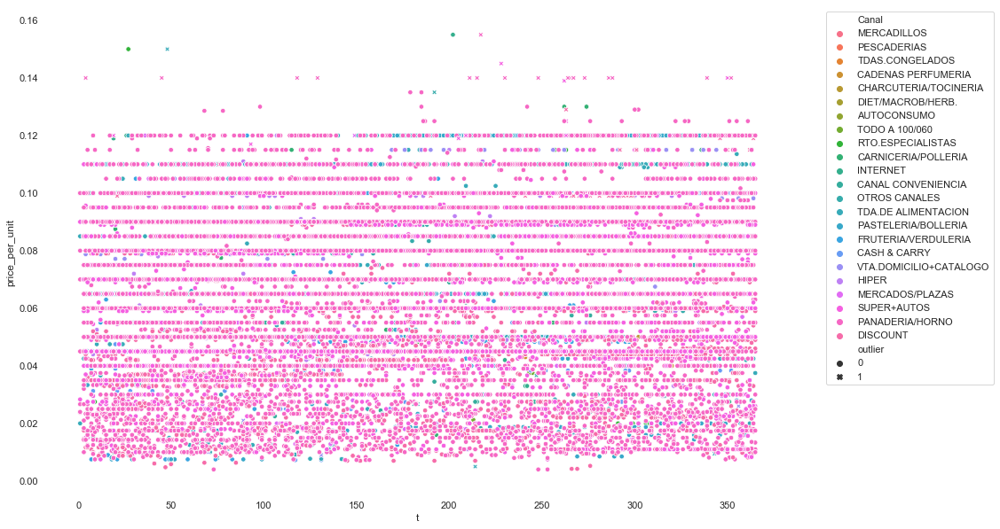

CodProducto                         62554
VF                   BEBIDA REFRESC. COLA
size                                    5
outlier_detection          vf_unit_simple
Name: 1776, dtype: object


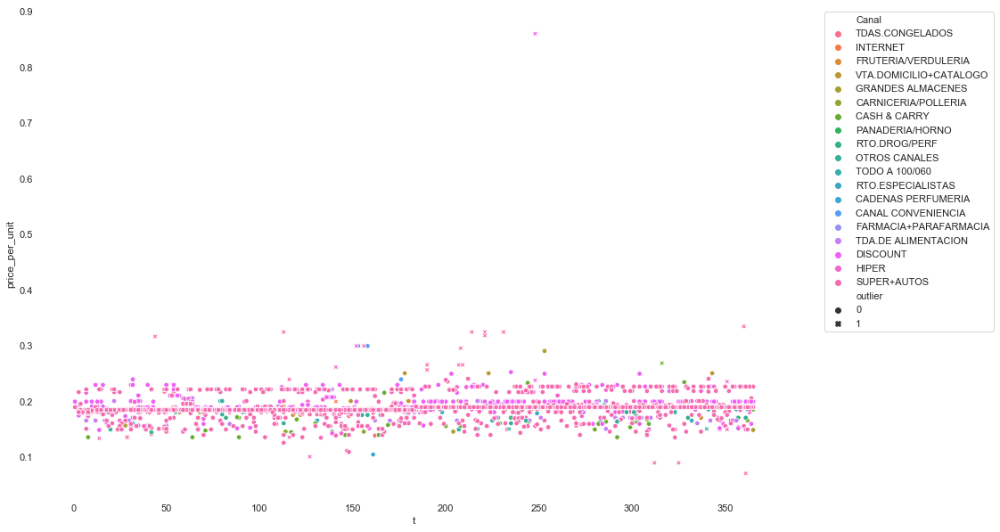

CodProducto                            204316
VF                   FRUTA FRESCA A PESO (CB)
size                                        8
outlier_detection              vf_unit_simple
Name: 4066, dtype: object


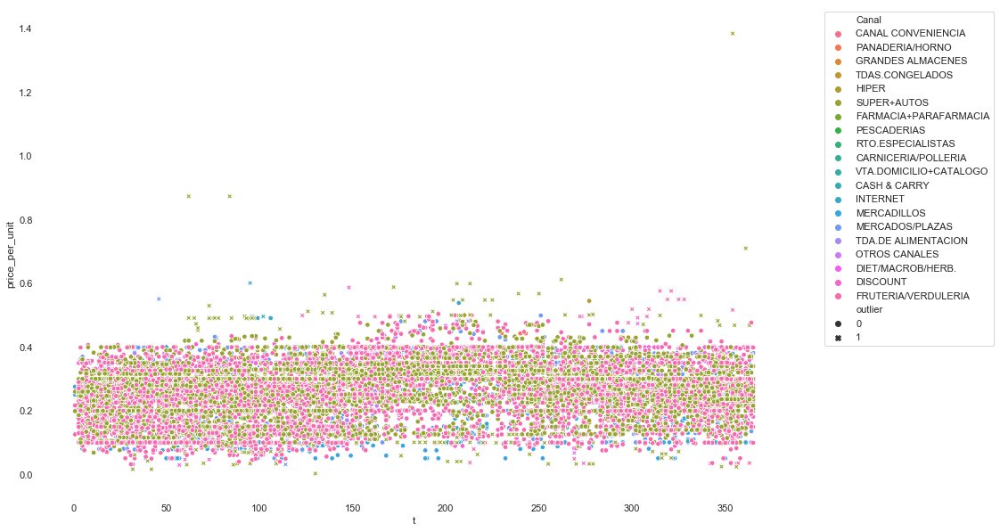

CodProducto                      325501
VF                   PAN FRESCO DEL DIA
size                                 72
outlier_detection            canal_poly
Name: 14024, dtype: object


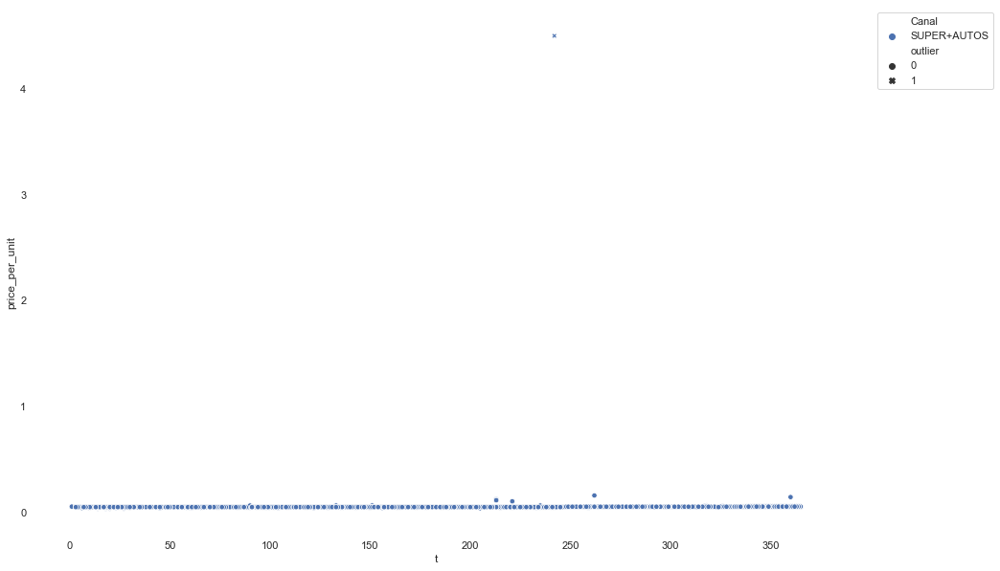

CodProducto                            204241
VF                   FRUTA FRESCA A PESO (CB)
size                                       13
outlier_detection              vf_unit_simple
Name: 15115, dtype: object


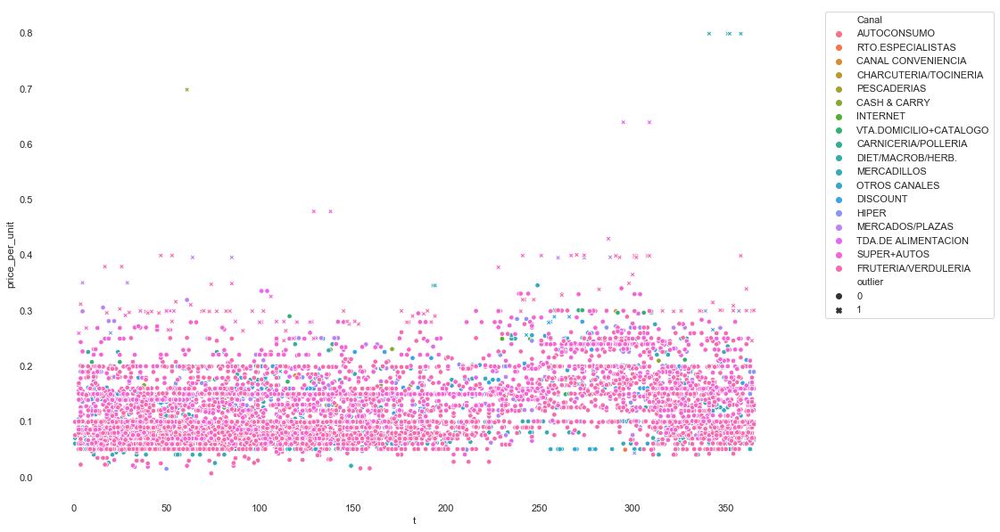

CodProducto                                  290622
VF                   VERDUR Y HORTAL FRESC A P (CB)
size                                              9
outlier_detection                    vf_unit_simple
Name: 17104, dtype: object


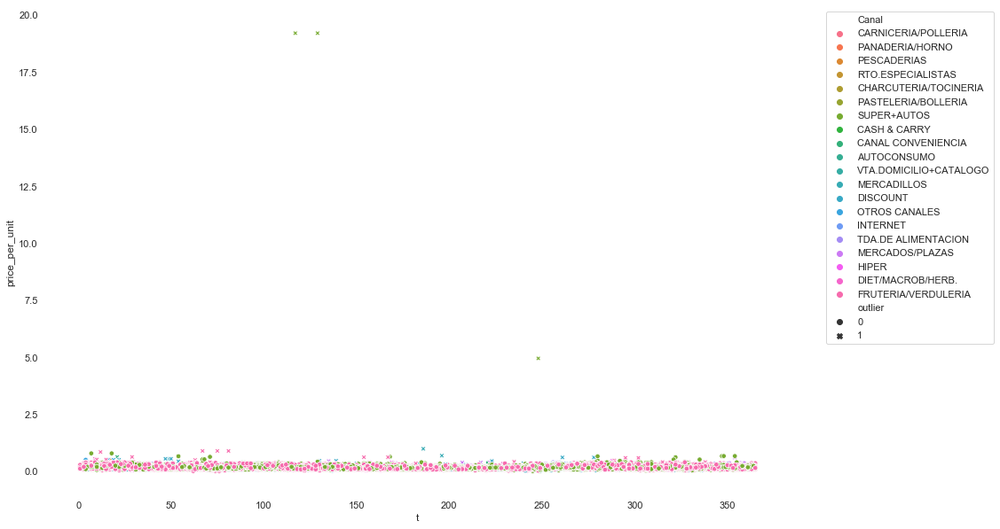

CodProducto                      391695
VF                   PAN FRESCO DEL DIA
size                                  4
outlier_detection        vf_unit_simple
Name: 18790, dtype: object


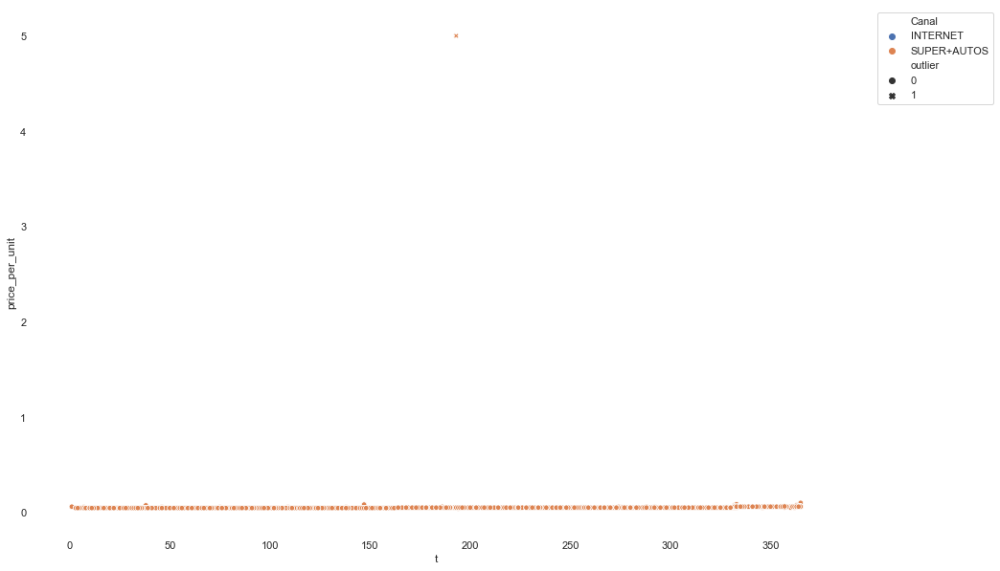

CodProducto                            683867
VF                   FRUTA FRESCA A PESO (CB)
size                                       15
outlier_detection              vf_unit_simple
Name: 22180, dtype: object


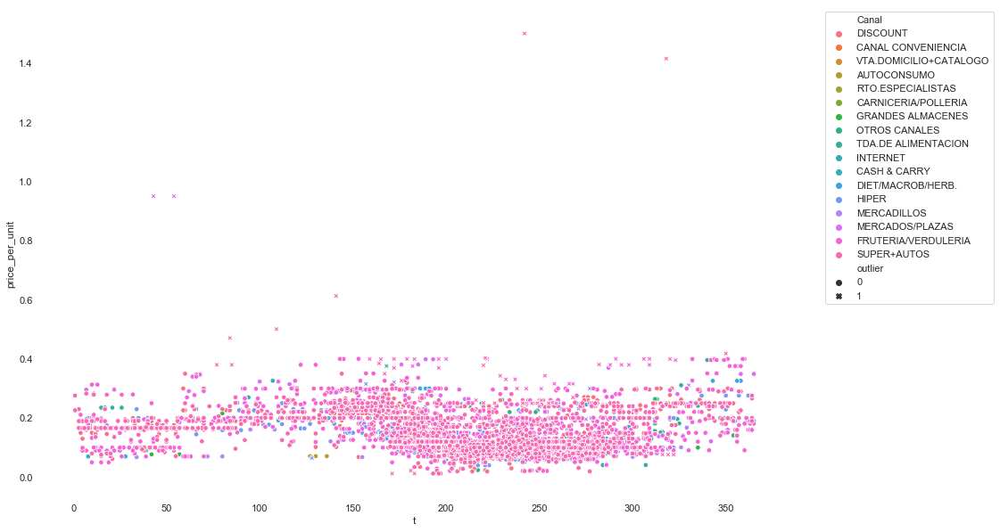

CodProducto                                  269969
VF                   VERDUR Y HORTAL FRESC A P (CB)
size                                              2
outlier_detection                    vf_unit_simple
Name: 69335, dtype: object


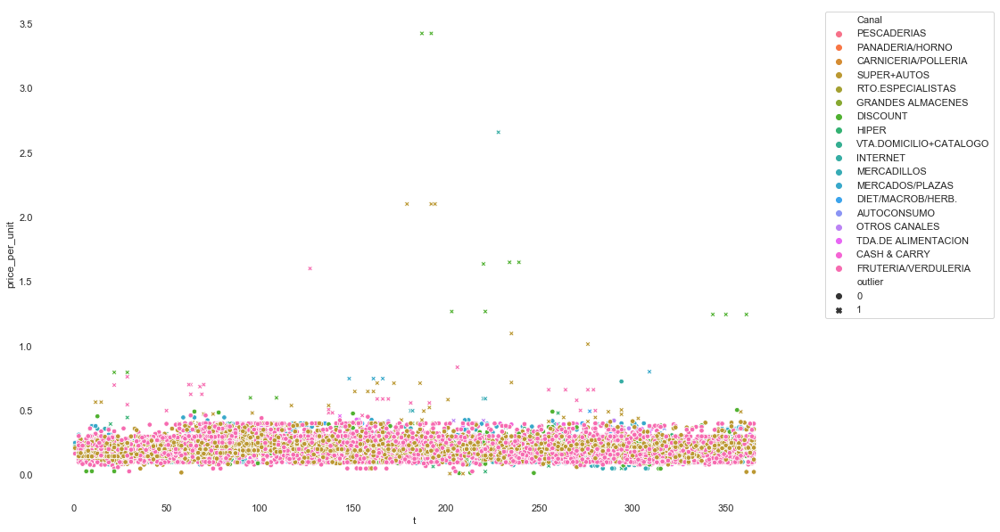

CodProducto                            290365
VF                   FRUTA FRESCA A PESO (CB)
size                                        5
outlier_detection              vf_unit_simple
Name: 52102, dtype: object


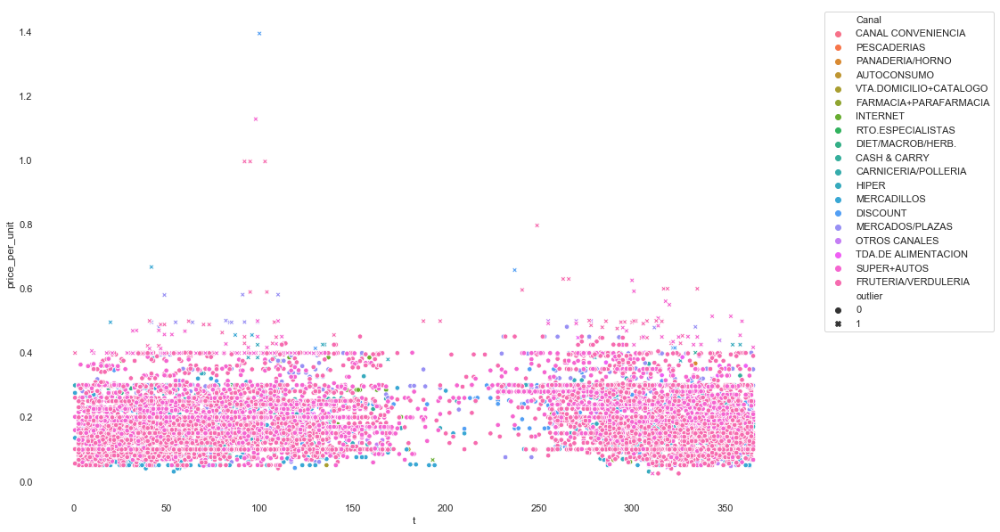

In [157]:

def show_price_data(df,codProd):
    data=df.loc[df['CodProducto']==codProd]
    print(data.iloc[0][['CodProducto','VF','size','outlier_detection']])    
    ax = sns.scatterplot(data=data, x="t", y="price_per_unit", hue='Canal',style="outlier", s=marker_size)
    
    #ax.set_xticklabels([datetime.fromtimestamp(ts / 1e9).strftime('%Y-%m-%d') for ts in ax.get_xticks()])
    '''
    for ind, label in enumerate(ax.get_xticklabels()):
        if ind % 2 == 0:  # every 10th label is kept
            label.set_visible(True)
        else:
            label.set_visible(False)
    '''
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    #plt.savefig(figure_dir)
    plt.show()

for cp in df['CodProducto'].sample(n=10):
    show_price_data(full_data,cp)
    

In [136]:
df.dtypes

index                             int32
idCompra                          int32
CodPanelista                      int32
CodProducto                       int32
FechaCesta               datetime64[ns]
                              ...      
Habitat_Metropolitano          category
Habitat_Municipal_Std          category
Inmigrante                         int8
Provincia                      category
Region                         category
Length: 95, dtype: object

In [148]:
source_df_test.head()

,idCompra,CodPanelista,CodProducto,CodigoBarras,FechaCesta,PrecioCompra,Cantidad,Precio,CodLugarCompra,Lugar_Compra,...,Clase_EGM,Clase_Social,Habitat_Metropolitano,Habitat_Municipal_Std,Inmigrante,Provincia,Region,promo_folleto,promo_envase,promo
0,191945938,364917,791031,8480000105424,2022-12-12,1650,12000,1716,79,Mercadona,...,Media,Media,AM Madrid,más 1000000,True,Madrid,MDD AM,NaN,NaN,False
1,190744241,30109,675179,8410702020886,2022-11-06,400,2000,400,28,CONDIS,...,Media Alta,Media,No Metrop,20001 a 30000,True,Jaen,Andalucia,NaN,NaN,False
2,182162741,30109,204305,SSA1410202,2022-01-20,2088,445,56,33,DIA,...,Media Alta,Media,No Metrop,20001 a 30000,True,Jaen,Andalucia,NaN,NaN,False
3,189827808,30109,204305,SSA1410202,2022-10-09,1071,625,87,33,DIA,...,Media Alta,Media,No Metrop,20001 a 30000,True,Jaen,Andalucia,NaN,NaN,False
4,182203652,30109,204305,SSA1410202,2022-01-12,969,935,83,33,DIA,...,Media Alta,Media,No Metrop,20001 a 30000,True,Jaen,Andalucia,NaN,NaN,False


In [151]:

def general_model(df):
    if df.shape[0]>30:
            # for throwing out outliers iteratively if we like, to have a better regression  
            cleaning_rounds=1
            Y = np.array(df['price_per_unit'])
            X = np.array(df['t'])
            #flag=np.zeros(y.size)
            idx=df[['price_per_unit']].index.copy()
            x=X.copy()
            y=Y.copy()
            print(x)
            for i in range(cleaning_rounds):
                p = np.polyfit(x, y, deg=5)
                ps = np.polyval(p, x)
                diff = abs(y-ps)
                std=np.std(diff)
                mean=np.mean(diff)
                good =  abs(diff-mean)/std < 3 
                #good = abs(y - ps) < 1  # Here we will only remove positive outliers
                    
                x_bad, y_bad = x[~good], y[~good]
                x, y = x[good], y[good]
        
           
        
                if (~good).sum() == 0:
                    break
            ps = np.polyval(p, X)
            diff = abs(Y-ps)
            std=np.std(diff)
            mean=np.mean(diff)
            z= abs(diff-mean)/std
            good =  z < 3 
            flag = np.logical_not(good)
          
            ret= pd.DataFrame(index=idx, data=list(zip(ps, z,flag)), columns=['1','2','3'])
    else:
        Y = np.array(df['price_per_unit'])
        #flag=np.zeros(y.size)
        idx=df[['price_per_unit']].index.copy()
        y=Y.copy()
    
        std=np.std(Y)
        mean=np.mean(Y)
        ps = np.full(y.shape, mean)
    
        z= abs(Y-mean)/std
        good =  z < 3 
        flag = np.logical_not(good)
      
        ret= pd.DataFrame(index=idx, data=list(zip(ps, z,flag)), columns=['1','2','3'])


    return ret


odf1 = source_df_test.copy()



odf1['t'] = odf1['FechaCesta'].astype('datetime64').dt.dayofyear
# calculate price per unit of sales
odf1['price_per_unit']= odf1['Precio']/odf1['Cantidad']

x=  odf1.groupby(['CodProducto'])[['t', 'price_per_unit']].apply(general_model)
     
x1 = x.reset_index().set_index('level_1').drop(['CodProducto'], axis=1)
odf1[['predicted', 'z', 'outlier']] = x1
odf1 = source_df_test.copy()

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/ipykernel_launcher.py:47: RuntimeWarning: invalid value encountered in true_divide


[351 329 356 364 351 340 353  45 364 338 351 357 344  32  12 356 344 328
 361 326 365 364 357 330 326 354 365 361 349 349 326 327 356  29  40  25
  10 341   5 338 332  11 357 339 354  35]
[357 357 349 185 119 153 255 134 178  55  25 123  76 307 343 277 152 119
 208 306 137 348  82 115  34 244 321 333  90 155 258  42  24 294 364 302
 146  62 246 314  94 325 330  69 255 173 231 195 101 276   5 314 204  56
 185 153 185  89 234 358 346 354]
[243 281 241 162 262 290  32 143 234 264  38  22  73 362  27  88  14  18
  32  84 249 346 264 258 299 237 234 312 335 284 241 290 255 327 293 138
 277 290 264 347  64  66  69  29 273 298 252 223 306 290 299 262 258 273
 131 231 347  49 174 126 306 262 251 312 291  28 316 194 346 103 272 286
 268 313 351 358 279 300 279 365 304 356 314 350 312  83 126  67 106 316
 302 286 281 154 279 258 280 359  28 159 134 176 315  40 270 136 112 216
  47 228 362 354  10 354 321 278 276 298 257 157 343 181 226 178 213 229
 337 288 252 147 180 175 257  20  90  28 335 220

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: invalid value encountered in true_divide
/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/ipykernel_launcher.py:32: RuntimeWarning: invalid value encountered in true_divide



[ 24  52  71  76 125 130 134 125 216  67  39  42 160  28 180 176 159  33
 134 169 127 113 176 141 155 183 176 134 118 196 148 159  48  69 153 134
 139  71  22 148 168 132 129  10  69 161 147  71]
[ 48  85  10 115 220  85  54  49 113  26  18 139  42  47  26 111 237  79
  46  88 143  30 114 140 215  32 137  24  47 341 120 257 362 112 139 139
 281  83 302  28  49 144 115 138 111  88 215 217  28  26 112  84 140  53
  26  31 315 113 171 129 356 274 236  84 110 242 115 113  87  53 120 140
  18   7  53 116  91 160 300 109  13 231  89 172  27 158  54 130  47  94
  24  31 248 318  17  52  27  68 141  47  82  70 111  53   7 129 110  90
 119 140 110 217  28 124  50 110  48 327  26  62  29  10  39  10 180 349
 356  14  83  90 118 151 115 139 112 116  30 111  15   7 110  29 321   7
  27 140 143 145 166 136 152 167 127 173  84 115  53  25  73  88 116  35
   5 133  56 267 171 363  28 301 139  26 166  82  82 328 186 108  73  14
 215  50 140  31 263 297 206 290 126 136 320 161  82  31  27  26 111 138


KeyError: "None of ['level_2'] are in the columns"

In [152]:
x.head()

1         2      3
CodProducto                                   
2           5158256  0.495000       NaN   True
4           176207   0.194997  0.928973  False
            183562   0.195001  1.644808  False
            183563   0.194994  0.187951  False
            220505   0.195005  0.354023  False

In [154]:
x.reset_index()

,CodProducto,level_1,1,2,3
0,2,5158256,0.495000,NaN,True
1,4,176207,0.194997,0.928973,False
2,4,183562,0.195001,1.644808,False
3,4,183563,0.194994,0.187951,False
4,4,220505,0.195005,0.354023,False
...,...,...,...,...,...
7584152,999763,7456494,0.190861,0.462107,False
7584153,999764,4561689,0.199000,NaN,True
7584154,999764,4561690,0.199000,NaN,True
7584155,999764,6431358,0.199000,NaN,True


In [156]:
x1=  x.reset_index().set_index('level_1').drop(['CodProducto'],axis=1)

In [158]:
odf1[['predicted', 'z', 'outlier']] = x1


CodProducto                     370419
VF             FRUTA Y VERDURA  FRESCA
Name: 68263, dtype: object
CodProducto                          217403
VF             PLATOS COCINADOS SECC.FRESCA
Name: 4291, dtype: object
CodProducto                            548326
VF             ESPECIALI. Y HELADO INDIVIDUAL
Name: 7907, dtype: object
CodProducto                            290623
VF             VERDUR Y HORTAL FRESC A P (CB)
Name: 2340, dtype: object
CodProducto                    612930
VF             BARRITAS NUTRICIONALES
Name: 211995, dtype: object
CodProducto           372385
VF             QUESO RALLADO
Name: 8952, dtype: object
CodProducto                  188019
VF             BEBIDA REFRESC. COLA
Name: 431, dtype: object
CodProducto                         791212
VF             PLATOS COCINADOS CONGELADOS
Name: 56394, dtype: object
CodProducto                    945458
VF             BARRITAS NUTRICIONALES
Name: 243159, dtype: object
CodProducto             417166
VF          

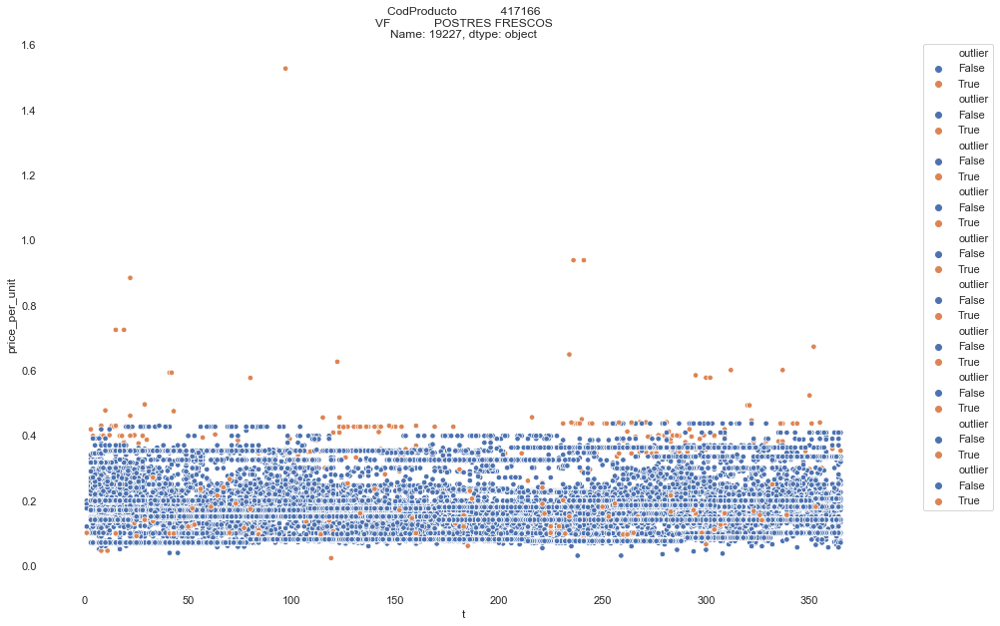

In [170]:

def show_price_data(df,codProd):
    data=df.loc[df['CodProducto']==codProd]
    print(data.iloc[0][['CodProducto','VF']])    
    ax = sns.scatterplot(data=data, x="t", y="price_per_unit", hue="outlier", s=marker_size).set(title=data.iloc[0][['CodProducto','VF']])
    
    #ax.set_xticklabels([datetime.fromtimestamp(ts / 1e9).strftime('%Y-%m-%d') for ts in ax.get_xticks()])
    '''
    for ind, label in enumerate(ax.get_xticklabels()):
        if ind % 2 == 0:  # every 10th label is kept
            label.set_visible(True)
        else:
            label.set_visible(False)
    '''
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.savefig(figure_dir+str(data.iloc[0]['CodProducto'])+".png")
    #plt.show()

for cp in odf1['CodProducto'].sample(n=10):
    show_price_data(odf1,cp)

In [160]:
odf1.to_csv(result_dir+'simple_outlier.csv')

In [161]:
odf1.head()

,idCompra,CodPanelista,CodProducto,CodigoBarras,FechaCesta,PrecioCompra,Cantidad,Precio,CodLugarCompra,Lugar_Compra,...,Provincia,Region,promo_folleto,promo_envase,promo,t,price_per_unit,predicted,z,outlier
0,191945938,364917,791031,8480000105424,2022-12-12,1650,12000,1716,79,Mercadona,...,Madrid,MDD AM,NaN,NaN,False,346,0.143000,0.143166,0.160957,False
1,190744241,30109,675179,8410702020886,2022-11-06,400,2000,400,28,CONDIS,...,Jaen,Andalucia,NaN,NaN,False,310,0.200000,0.266667,1.414214,False
2,182162741,30109,204305,SSA1410202,2022-01-20,2088,445,56,33,DIA,...,Jaen,Andalucia,NaN,NaN,False,20,0.125843,0.113056,0.077869,False
3,189827808,30109,204305,SSA1410202,2022-10-09,1071,625,87,33,DIA,...,Jaen,Andalucia,NaN,NaN,False,282,0.139200,0.136567,0.426895,False
4,182203652,30109,204305,SSA1410202,2022-01-12,969,935,83,33,DIA,...,Jaen,Andalucia,NaN,NaN,False,12,0.088770,0.109690,0.201687,False


In [162]:
odf1.shape[0]

7584157

In [163]:
source_df_test.shape[0]

7584157

In [164]:
odf1.dtypes

idCompra                   int64
CodPanelista               int64
CodProducto                int64
CodigoBarras              object
FechaCesta        datetime64[ns]
                       ...      
t                          int64
price_per_unit           float64
predicted                float64
z                        float64
outlier                     bool
Length: 94, dtype: object

In [165]:
odf1.loc[odf1['outlier']==True].shape[0]

186069

In [168]:
# separating the tables:
for name,attributes in tables.items():
    if name=='purchases':
        attributes+=['outlier']
    odf1[attributes].drop_duplicates().to_csv(data_dir+f'{year}_{name}.csv')    